<a href="https://colab.research.google.com/github/honghaozhen/ME343/blob/main/Muti_agent_4_13_testing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import cvxpy as cp
import matplotlib.pyplot as plt
from scipy.optimize import minimize
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from matplotlib.patches import Circle

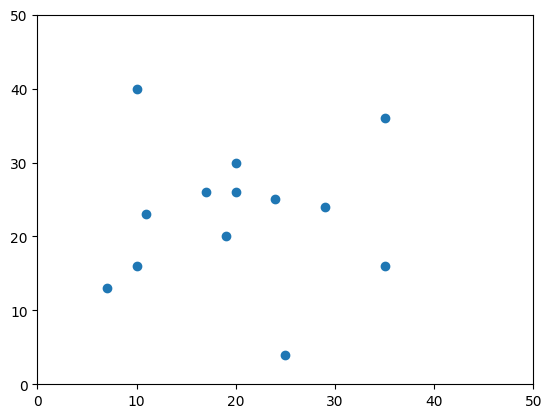

In [ ]:
# Create static obstacle
#obst_x = np.random.choice(range(10, 41), 8)
#obst_y = np.random.choice(range(10, 41), 8)
obst_x = [24, 17, 20, 29, 19, 35, 35, 10, 20, 10,  7, 11, 25]
obst_y = [25, 26, 30, 24, 20, 36, 16, 16, 26, 40, 13, 23,  4]
plt.scatter(obst_x, obst_y)
plt.xlim(0, 50)
plt.ylim(0, 50)
plt.show()
obstacles_list = np.vstack((obst_x, obst_y)).T

In [ ]:
def attractor(c1, error):
    return c1 * error

def repulsor(k, c2, current_location, obstacles_list):
    sum = np.zeros((2, 1))
    p = current_location
    o = obstacles_list
    sign_x = 0
    sign_y = 0
    for i in range(len(obstacles_list)):
        ost = o[i].reshape((2, 1))
        xy = k * np.exp((-np.square(np.linalg.norm(p - ost, 2))) / c2)
        if ost[0] >= p[0]:
            sign_x = 1
        else:
            sign_x = -1
        if ost[1] >= p[1]:
            sign_y = 1
        else:
            sign_y = -1
        sum[0] += sign_x * xy
        sum[1] += sign_y * xy
    return sum

def moving(start_point, goal_point, c1, c2, k, obstacles_list):
    current_locations_list = []
    u_control_list = []
    current_location = start_point.reshape((2, 1))
    u_init = np.zeros((2, 1))
    goal_point = goal_point.reshape((2 , 1))
    current_locations_list.append(current_location)
    u_control_list.append(u_init)
    tol = 1
    i = 0
    while np.linalg.norm(current_location - goal_point) >= tol:
        error = goal_point - current_location
        error = error / np.linalg.norm(error)
        # output the linear control for experiment
        # attractor + repulsor result the speed for next step
        u_control = attractor(c1, error) - repulsor(k, c2, current_location, obstacles_list)
        next_point = current_location + u_control
        current_locations_list.append(next_point)
        u_control_list.append(u_control)
        current_location = next_point
        i += 1
        if i >= 600:
            break
    for i in current_locations_list:
        for j in obstacles_list:
            if np.linalg.norm(i - j) <= 1:
                print('hit something!', 'current location', i, 'Obstacle location', j)
    return current_locations_list, u_control_list


In [ ]:
def is_in_circle(position, other_position, R):
    relative_position = other_position - position
    distance = np.linalg.norm(relative_position)
    
    if distance <= R:
        return True
    else:
        return False


In [ ]:
def moving_multiple_agents(start_points, goal_points, c1_values, c2_values, k_values, obstacles_list, radii, max_iterations=400, tol=1):
    num_agents = len(start_points)
    current_locations = [start_point.reshape((2, 1)) for start_point in start_points]
    goal_points = [goal_point.reshape((2, 1)) for goal_point in goal_points]
    trajectories = [[] for _ in range(num_agents)]

    for i in range(num_agents):
        trajectories[i].append(current_locations[i])

    iteration = 0
    while iteration < max_iterations:
        for i in range(num_agents):
            if np.linalg.norm(current_locations[i] - goal_points[i]) < tol:
                continue

            error = goal_points[i] - current_locations[i]
            error = error / np.linalg.norm(error)
            visible_obstacles = obstacles_list.copy()

            for j in range(num_agents):
                if i != j and is_in_circle(current_locations[i], current_locations[j], radii[i]):
                    visible_obstacles = np.vstack([visible_obstacles, current_locations[j].T])

            u_control = attractor(c1_values[i], error) - repulsor(k_values[i], c2_values[i], current_locations[i], visible_obstacles)
            next_point = current_locations[i] + u_control
            trajectories[i].append(next_point)
            current_locations[i] = next_point
        iteration += 1

    return trajectories


In [ ]:
start_points = [np.array([x_start, y_start]) for x_start, y_start in [(3, 12), (3, 14), (5, 16), (6, 18), (7, 20), (20, 0)]]
goal_points = [np.array([x_goal, y_goal]) for x_goal, y_goal in [(37, 32), (37, 26), (37, 22), (37, 12), (37, 28), (20, 35)]]

In [ ]:
np.random.seed(0)  # Set a random seed for reproducibility

c1_values = np.random.uniform(0.1, 1, size=6)
c2_values = np.random.uniform(0.5, 1, size=6)
k_values = np.random.uniform(3, 4, size=6)
radii = np.random.uniform(1, 3, size=6)

In [ ]:
trajectories = moving_multiple_agents(start_points, goal_points, c1_values, c2_values, k_values, obstacles_list, radii)

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

fig, ax = plt.subplots(figsize=(8, 8))
colors = ['b', 'g', 'r', 'c', 'm', 'y']
def update(frame):
    ax.clear()
    ax.set_xlim(0, 40)
    ax.set_ylim(0, 40)
    for i in range(6):
        traj = np.array(trajectories[i][:frame+1]).squeeze()
        if traj.ndim == 1:
            x_traj, y_traj = traj
            ax.scatter(x_traj, y_traj, color=colors[i], marker='o', label=f'Agent {i+1}')
            agent_circle = Circle((x_traj, y_traj), radii[i], color=colors[i], fill=False)
        elif traj.ndim == 2:
            x_traj, y_traj = traj.T
            ax.plot(x_traj, y_traj, color=colors[i], label=f'Agent {i+1}')
            ax.scatter(x_traj[-1], y_traj[-1], color=colors[i], marker='o')
            agent_circle = Circle((x_traj[-1], y_traj[-1]), radii[i], color=colors[i], fill=False)
        ax.add_artist(agent_circle)
    ax.scatter(obst_x, obst_y, label="Obstacle")
    ax.legend()
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('Trajectories of 6 Agents Avoiding Each Other and Obstacles')

ani = FuncAnimation(fig, update, frames=len(trajectories[0]), interval=100, repeat=True)
plt.close()
HTML(ani.to_jshtml())


In [ ]:
from scipy.optimize import least_squares

def cost_function(params, observed_trajectories, start_points, goal_points):
    num_agents = len(start_points)
    c1_values, c2_values, k_values, radii = np.split(params, 4)
    c1_values = np.abs(c1_values)
    c2_values = np.abs(c2_values)
    k_values = np.abs(k_values)
    radii = np.abs(radii)

    estimated_trajectories = moving_multiple_agents(start_points, goal_points, c1_values, c2_values, k_values, obstacles_list, radii)

    cost = 0
    for i in range(num_agents):
        observed_traj = np.array(observed_trajectories[i]).squeeze()
        estimated_traj = np.array(estimated_trajectories[i]).squeeze()

        # Calculate the mean squared error for the available steps in both trajectories
        min_length = min(len(observed_traj), len(estimated_traj))
        mse = np.mean((observed_traj[:min_length] - estimated_traj[:min_length]) ** 2)

        cost += mse

    return cost / num_agents


num_agents = len(start_points)
np.random.seed(5)
c1_init = np.random.uniform(0.1, 1, num_agents)
c2_init = np.random.uniform(0.5, 1, num_agents)
k_init = np.random.uniform(3, 4, num_agents)
radii_init = np.random.uniform(1, 3, num_agents)

params_initial = np.concatenate([c1_init, c2_init, k_init, radii_init])

result = least_squares(cost_function, params_initial, args=(trajectories, start_points, goal_points))

estimated_c1_values, estimated_c2_values, estimated_k_values, estimated_radii = np.split(result.x, 4)


In [ ]:
print('c1', estimated_c1_values)
print('c2', estimated_c2_values)
print('k', estimated_k_values)
print('radii', estimated_radii)

c1 [1.31170263 0.76824391 0.6521612  0.76896354 0.48621223 0.64895673]
c2 [0.78781978 0.75916074 0.64856252 0.59734549 0.53988051 0.8703826 ]
k [3.4254191  3.15251232 3.87782102 3.27384426 3.41422979 3.2962236 ]
radii [2.25757582 2.15967562 2.19985839 1.53163824 1.56937176 1.50717641]


In [ ]:
print('real_c1', c1_values)
print('real_c2', c2_values)
print('real_k', k_values)
print('real_radii', radii)

real_c1 [0.59393215 0.74367043 0.64248704 0.59039486 0.48128932 0.6813047 ]
real_c2 [0.93758721 1.391773   1.46366276 0.88344152 1.29172504 1.02889492]
real_k [1.56804456 1.92559664 1.07103606 1.0871293  1.0202184  1.83261985]
real_radii [1.66723513 1.80501822 1.96792751 1.69873785 1.19221904 1.67079376]


In [ ]:
trajectories_estimated = moving_multiple_agents(start_points, goal_points, estimated_c1_values, estimated_c2_values, estimated_k_values, obstacles_list, estimated_radii)

In [ ]:
fig, ax = plt.subplots(figsize=(8, 8))
colors = ['b', 'g', 'r', 'c', 'm', 'y']
def update(frame):
    ax.clear()
    ax.set_xlim(0, 40)
    ax.set_ylim(0, 40)
    for i in range(6):
        traj = np.array(trajectories_estimated[i][:frame+1]).squeeze()
        if traj.ndim == 1:
            x_traj, y_traj = traj
            ax.scatter(x_traj, y_traj, color=colors[i], marker='o', label=f'Agent {i+1}')
            agent_circle = Circle((x_traj, y_traj), radii[i], color=colors[i], fill=False)
        elif traj.ndim == 2:
            x_traj, y_traj = traj.T
            ax.plot(x_traj, y_traj, color=colors[i], label=f'Agent {i+1}')
            ax.scatter(x_traj[-1], y_traj[-1], color=colors[i], marker='o')
            agent_circle = Circle((x_traj[-1], y_traj[-1]), radii[i], color=colors[i], fill=False)
        ax.add_artist(agent_circle)
    ax.scatter(obst_x, obst_y, label="Obstacle")
    ax.legend()
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('Trajectories_estimated of 6 Agents Avoiding Each Other and Obstacles')

ani = FuncAnimation(fig, update, frames=len(trajectories[0]), interval=100, repeat=True)
plt.close()
HTML(ani.to_jshtml())


In [ ]:
from scipy.optimize import minimize

def cost_function(params, observed_trajectories, start_points, goal_points):
    num_agents = len(start_points)
    c1_values, c2_values, k_values, radii = np.split(params, 4)
    c1_values = np.abs(c1_values)
    c2_values = np.abs(c2_values)
    k_values = np.abs(k_values)
    radii = np.abs(radii)

    estimated_trajectories = moving_multiple_agents(start_points, goal_points, c1_values, c2_values, k_values, obstacles_list, radii)

    cost = 0
    for i in range(num_agents):
        observed_traj = np.array(observed_trajectories[i]).squeeze()
        estimated_traj = np.array(estimated_trajectories[i]).squeeze()

        # Calculate the mean squared error for the available steps in both trajectories
        min_length = min(len(observed_traj), len(estimated_traj))
        cost += np.sum((observed_traj[:min_length] - estimated_traj[:min_length]) ** 2)

    return cost / (num_agents * len(observed_trajectories[0]))

np.random.seed(5)
c1_init = np.random.uniform(0.1, 1, num_agents)
c2_init = np.random.uniform(0.5, 1, num_agents)
k_init = np.random.uniform(3, 4, num_agents)
radii_init = np.random.uniform(1, 3, num_agents)

params_initial = np.concatenate([c1_init, c2_init, k_init, radii_init])

result = minimize(cost_function, params_initial, args=(trajectories, start_points, goal_points), method='BFGS')

estimated_c1_values, estimated_c2_values, estimated_k_values, estimated_radii = np.split(result.x, 4)


$$ u = c_1 * \hat{e} + \sum_i \left(k * exp \left(-\frac{||p_{ego}-o_i||^2}{c_2} \right) \right) * \hat{(p_{ego}-o_i)} \cdot \underbrace{\phi_{bool}((p_{ego}-o_i) < R_{obs})}_{observation} $$


c1 [0.80656354 0.85543796 0.60503932 0.80674168 0.46181379 0.65932656]
c2 [0.8758454  0.75771708 0.65450908 0.59781755 0.54170201 0.86930128]
k [3.44091053 3.15816732 3.88050247 3.27431958 3.41433517 3.29608598]
radii [2.25757582 2.15967562 2.19985839 1.53163824 1.56937176 1.50717641]


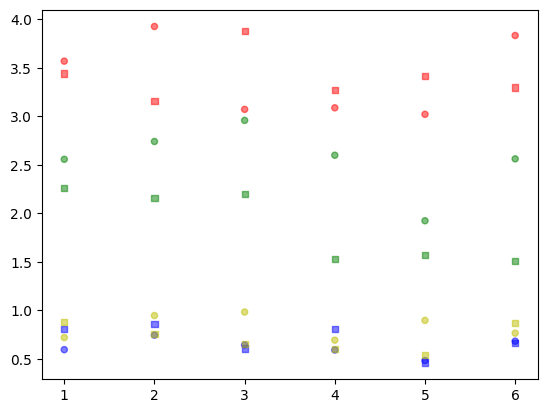

In [ ]:
print('c1', estimated_c1_values)
print('c2', estimated_c2_values)
print('k', estimated_k_values)
print('radii', estimated_radii)
#real_c1 [0.59393215 0.74367043 0.64248704 0.59039486 0.48128932 0.6813047 ]
#real_c2 [0.71879361 0.9458865  0.98183138 0.69172076 0.89586252 0.76444746]
#real_k [3.56804456 3.92559664 3.07103606 3.0871293  3.0202184  3.83261985]
#real_radii [2.5563135  2.7400243  2.95723668 2.59831713 1.92295872 2.56105835]
real_c1 = np.matrix([0.59393215, 0.74367043, 0.64248704, 0.59039486, 0.48128932, 0.6813047 ])
real_c2 = np.matrix( [0.71879361, 0.9458865 , 0.98183138, 0.69172076, 0.89586252, 0.76444746])
real_k = np.matrix( [3.56804456, 3.92559664, 3.07103606 ,3.0871293,  3.0202184,  3.83261985])
real_radii = np.matrix( [2.5563135,  2.7400243,  2.95723668 ,2.59831713, 1.92295872, 2.56105835])

r = [1,2,3,4,5,6]
import matplotlib.pyplot as plt

# Fixing random state for reproducibility
np.random.seed(19680801)
area = 20
colors = np.random.rand(6)
real_c1 = np.asarray(real_c1)
real_c2 = np.asarray(real_c2)
real_k = np.asarray(real_k)
real_radii = np.asarray(real_radii)
plt.scatter(r, real_c1, s=area, c=['b','b','b','b','b','b'], alpha=0.5)
plt.scatter(r, real_c2, s=area, c=['y','y','y','y','y','y'], alpha=0.5)
plt.scatter(r, real_k, s=area, c=['r','r','r','r','r','r'], alpha=0.5)
plt.scatter(r, real_radii, s=area, c=['g','g','g','g','g','g'], alpha=0.5)

plt.scatter(r, estimated_c1_values, s=area, c=['b','b','b','b','b','b'], alpha=0.5, marker = 's')
plt.scatter(r, estimated_c2_values, s=area, c=['y','y','y','y','y','y'], alpha=0.5, marker = 's')
plt.scatter(r, estimated_k_values, s=area, c=['r','r','r','r','r','r'], alpha=0.5, marker = 's')
plt.scatter(r, estimated_radii, s=area, c=['g','g','g','g','g','g'], alpha=0.5, marker = 's')

plt.show()






In [ ]:
trajectories_estimated = moving_multiple_agents(start_points, goal_points, estimated_c1_values, estimated_c2_values, estimated_k_values, obstacles_list, estimated_radii, max_iterations=500)

In [ ]:
fig, ax = plt.subplots(figsize=(8, 8))
colors = ['b', 'g', 'r', 'c', 'm', 'y']
def update(frame):
    ax.clear()
    ax.set_xlim(0, 40)
    ax.set_ylim(0, 40)
    for i in range(6):
        traj = np.array(trajectories_estimated[i][:frame+1]).squeeze()
        if traj.ndim == 1:
            x_traj, y_traj = traj
            ax.scatter(x_traj, y_traj, color=colors[i], marker='o', label=f'Agent {i+1}')
            agent_circle = Circle((x_traj, y_traj), radii[i], color=colors[i], fill=False)
        elif traj.ndim == 2:
            x_traj, y_traj = traj.T
            ax.plot(x_traj, y_traj, color=colors[i], label=f'Agent {i+1}')
            ax.scatter(x_traj[-1], y_traj[-1], color=colors[i], marker='o')
            agent_circle = Circle((x_traj[-1], y_traj[-1]), radii[i], color=colors[i], fill=False)
        ax.add_artist(agent_circle)
    ax.scatter(obst_x, obst_y, label="Obstacle")
    ax.legend()
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('Trajectories_estimated of 6 Agents Avoiding Each Other and Obstacles')

ani = FuncAnimation(fig, update, frames=len(trajectories[0]), interval=100, repeat=True)
plt.close()
HTML(ani.to_jshtml())


In [ ]:
print('c1', estimated_c1_values)
print('c2', estimated_c2_values)
print('k', estimated_k_values)
print('radii', estimated_radii)
#real_c1 [0.59393215 0.74367043 0.64248704 0.59039486 0.48128932 0.6813047 ]
#real_c2 [0.71879361 0.9458865  0.98183138 0.69172076 0.89586252 0.76444746]
#real_k [3.56804456 3.92559664 3.07103606 3.0871293  3.0202184  3.83261985]
#real_radii [2.5563135  2.7400243  2.95723668 2.59831713 1.92295872 2.56105835]

In [ ]:
#For very small radian
np.random.seed(0)

c1_values = np.random.uniform(0.1, 1, size=6)
c2_values = np.random.uniform(0.5, 1.5, size=6)
k_values = np.random.uniform(1, 2, size=6)
radii = np.random.uniform(0.5, 2, size=6)

In [ ]:
trajectories = moving_multiple_agents(start_points, goal_points, c1_values, c2_values, k_values, obstacles_list, radii)

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

fig, ax = plt.subplots(figsize=(8, 8))
colors = ['b', 'g', 'r', 'c', 'm', 'y']
def update(frame):
    ax.clear()
    ax.set_xlim(0, 40)
    ax.set_ylim(0, 40)
    for i in range(6):
        traj = np.array(trajectories[i][:frame+1]).squeeze()
        if traj.ndim == 1:
            x_traj, y_traj = traj
            ax.scatter(x_traj, y_traj, color=colors[i], marker='o', label=f'Agent {i+1}')
            agent_circle = Circle((x_traj, y_traj), radii[i], color=colors[i], fill=False)
        elif traj.ndim == 2:
            x_traj, y_traj = traj.T
            ax.plot(x_traj, y_traj, color=colors[i], label=f'Agent {i+1}')
            ax.scatter(x_traj[-1], y_traj[-1], color=colors[i], marker='o')
            agent_circle = Circle((x_traj[-1], y_traj[-1]), radii[i], color=colors[i], fill=False)
        ax.add_artist(agent_circle)
    ax.scatter(obst_x, obst_y, label="Obstacle")
    ax.legend()
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('Trajectories of 6 Agents Avoiding Each Other and Obstacles')

ani = FuncAnimation(fig, update, frames=len(trajectories[0]), interval=100, repeat=True)
plt.close()
HTML(ani.to_jshtml())


In [ ]:
from scipy.optimize import minimize

def cost_function(params, observed_trajectories, start_points, goal_points):
    num_agents = len(start_points)
    c1_values, c2_values, k_values, radii = np.split(params, 4)
    c1_values = np.abs(c1_values)
    c2_values = np.abs(c2_values)
    k_values = np.abs(k_values)
    radii = np.abs(radii)

    estimated_trajectories = moving_multiple_agents(start_points, goal_points, c1_values, c2_values, k_values, obstacles_list, radii)

    cost = 0
    for i in range(num_agents):
        observed_traj = np.array(observed_trajectories[i]).squeeze()
        estimated_traj = np.array(estimated_trajectories[i]).squeeze()

        # Calculate the mean squared error for the available steps in both trajectories
        min_length = min(len(observed_traj), len(estimated_traj))
        cost += np.sum((observed_traj[:min_length] - estimated_traj[:min_length]) ** 2)

    return cost / (num_agents * len(observed_trajectories[0]))

np.random.seed(5)
c1_init = np.random.uniform(0.1, 1, num_agents)
c2_init = np.random.uniform(0.5, 1, num_agents)
k_init = np.random.uniform(3, 4, num_agents)
radii_init = np.random.uniform(1, 3, num_agents)

params_initial = np.concatenate([c1_init, c2_init, k_init, radii_init])

result = minimize(cost_function, params_initial, args=(trajectories, start_points, goal_points), method='BFGS')

estimated_c1_values, estimated_c2_values, estimated_k_values, estimated_radii = np.split(result.x, 4)


In [ ]:
print('c1', estimated_c1_values)
print('c2', estimated_c2_values)
print('k', estimated_k_values)
print('radii', estimated_radii)

c1 [1.31170263 0.76824391 0.6521612  0.76896354 0.48621223 0.64895673]
c2 [0.78781978 0.75916074 0.64856252 0.59734549 0.53988051 0.8703826 ]
k [3.4254191  3.15251232 3.87782102 3.27384426 3.41422979 3.2962236 ]
radii [2.25757582 2.15967562 2.19985839 1.53163824 1.56937176 1.50717641]


In [ ]:
print('real_c1', c1_values)
print('real_c2', c2_values)
print('real_k', k_values)
print('real_radii', radii)

real_c1 [0.59393215 0.74367043 0.64248704 0.59039486 0.48128932 0.6813047 ]
real_c2 [0.93758721 1.391773   1.46366276 0.88344152 1.29172504 1.02889492]
real_k [3.56804456 3.92559664 3.07103606 3.0871293  3.0202184  3.83261985]
real_radii [1.66723513 1.80501822 1.96792751 1.69873785 1.19221904 1.67079376]


In [ ]:
trajectories_estimated = moving_multiple_agents(start_points, goal_points, estimated_c1_values, estimated_c2_values, estimated_k_values, obstacles_list, estimated_radii, max_iterations=500)

In [ ]:
fig, ax = plt.subplots(figsize=(8, 8))
colors = ['b', 'g', 'r', 'c', 'm', 'y']
def update(frame):
    ax.clear()
    ax.set_xlim(0, 40)
    ax.set_ylim(0, 40)
    for i in range(6):
        traj = np.array(trajectories_estimated[i][:frame+1]).squeeze()
        if traj.ndim == 1:
            x_traj, y_traj = traj
            ax.scatter(x_traj, y_traj, color=colors[i], marker='o', label=f'Agent {i+1}')
            agent_circle = Circle((x_traj, y_traj), radii[i], color=colors[i], fill=False)
        elif traj.ndim == 2:
            x_traj, y_traj = traj.T
            ax.plot(x_traj, y_traj, color=colors[i], label=f'Agent {i+1}')
            ax.scatter(x_traj[-1], y_traj[-1], color=colors[i], marker='o')
            agent_circle = Circle((x_traj[-1], y_traj[-1]), radii[i], color=colors[i], fill=False)
        ax.add_artist(agent_circle)
    ax.scatter(obst_x, obst_y, label="Obstacle")
    ax.legend()
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('Trajectories_estimated of 6 Agents Avoiding Each Other and Obstacles')

ani = FuncAnimation(fig, update, frames=len(trajectories[0]), interval=100, repeat=True)
plt.close()
HTML(ani.to_jshtml())
